## Analisi per settore

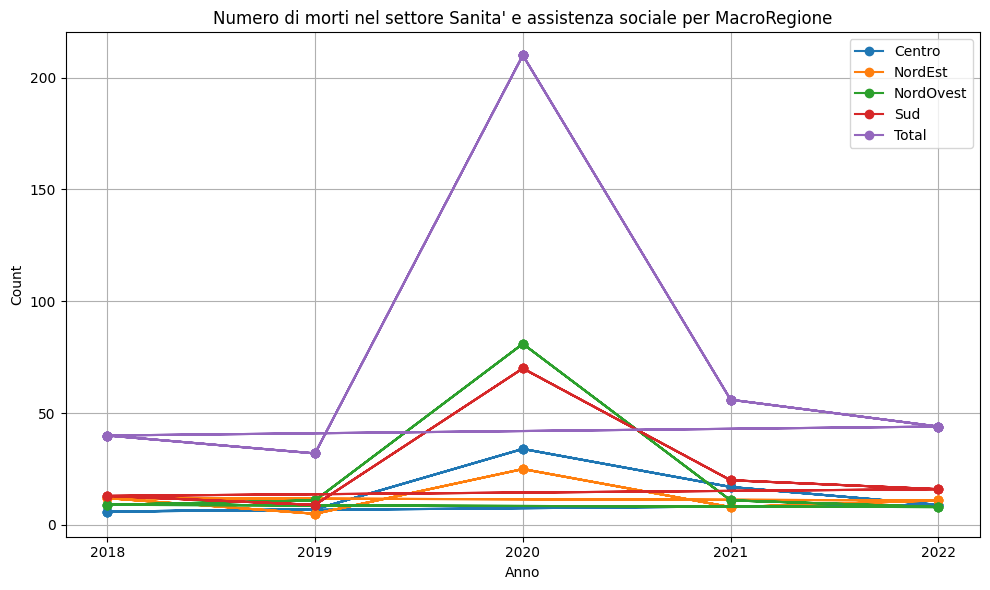

In [20]:
import pandas as pd
import matplotlib.pyplot as plt

# Carica il CSV in un DataFrame
df = pd.read_csv('../tabelle/morti_settore.csv')

# Filtra i dati per 'Sanita' e assistenza sociale'
filtered_data = df[df['DescrAtecoLiv1'] == "Sanita' e assistenza sociale"]

# Prepara il grafico
plt.figure(figsize=(10, 6))

# Itera sulle MacroRegioni per creare una linea per ciascuna
for regione, data in filtered_data.groupby('MacroRegione'):
    plt.plot(data['Year'], data['Count'], marker='o', label=regione)

plt.title('Numero di morti nel settore Sanita\' e assistenza sociale per MacroRegione')
plt.xlabel('Anno')
plt.ylabel('Count')
plt.xticks(filtered_data['Year'].unique())  # Imposta solo gli anni unici sull'asse x
plt.legend()
plt.grid(True)
plt.tight_layout()

# Mostra il grafico
plt.show()

In [ ]:
// Imposta il tema di default di AmCharts
am4core.useTheme(am4themes_animated);

// Crea un istanza del grafico
var chart = am4core.create("chartdiv", am4charts.XYChart);

// Imposta il percorso del file da cui ottenere i dati
chart.dataSource.url = "../tabelle/morti_settore";

// Crea assi X e Y
var categoryAxis = chart.xAxes.push(new am4charts.CategoryAxis());
categoryAxis.dataFields.category = "settori";
categoryAxis.renderer.grid.template.location = 0;
categoryAxis.renderer.minGridDistance = 30;

var valueAxis = chart.yAxes.push(new am4charts.ValueAxis());
valueAxis.title.text = "Numero di morti";

// Crea la serie di colonne per visualizzare i dati
var series = chart.series.push(new am4charts.ColumnSeries());
series.dataFields.valueY = "morti";
series.dataFields.categoryX = "settori";
series.name = "Numero di morti";
series.columns.template.tooltipText = "{categoryX}: [bold]{valueY}[/]";

// Imposta le colonne a essere arrotondate
series.columns.template.adapter.add("cornerRadiusTopLeft", function(corner, target) {
  if (target.dataItem && target.dataItem.valueY > 0) {
    return 10;
  }
  return corner;
});

series.columns.template.adapter.add("cornerRadiusTopRight", function(corner, target) {
  if (target.dataItem && target.dataItem.valueY > 0) {
    return 10;
  }
  return corner;
});

// Aggiungi un cursore di tooltip
chart.cursor = new am4charts.XYCursor();

// Imposta il cursore del grafico come zoomable
chart.scrollbarX = new am4core.Scrollbar();

// Imposta i cursori come inizializzati
chart.dataSource.events.on("inited", function() {
  chart.cursor.triggerMove({ x: chart.plotContainer.pixelWidth / 2, y: chart.plotContainer.pixelHeight / 2 });
});

// Alla fine, carica i dati dal file
chart.dataSource.load();


## Analisi per genere

#### Feriti (genere)

In [15]:
import pandas as pd
import plotly.express as px
import plotly.io as pio  # Importa plotly.io per la funzione write_html
from ipywidgets import interact

# Caricamento dei dati
df = pd.read_csv('../tabelle/feriti_genere.csv')

# Raggruppa per MacroRegione, Year e Genere, sommando Count
df_grouped = df.groupby(['MacroRegione', 'Year', 'Genere']).sum().reset_index()

# Funzione per creare il grafico interattivo e salvarlo come HTML
def plot_feriti(anno):
    df_filtered = df_grouped[df_grouped['Year'] == anno]
    fig = px.bar(df_filtered, 
                 x='Count', 
                 y='MacroRegione', 
                 color='Genere', 
                 barmode='stack',
                 labels={'Count': 'Numero di feriti', 'MacroRegione': 'MacroRegioni'},
                 title=f'Numero di feriti per genere nelle MacroRegioni - {anno}')
    fig.show()
    
    # Salva il grafico come HTML
    pio.write_html(fig, file=f'grafico_feriti_{anno}.html', auto_open=False)

# Creazione del widget di selezione dell'anno
anni_disponibili = df_grouped['Year'].unique()
interact(plot_feriti, anno=anni_disponibili)


interactive(children=(Dropdown(description='anno', options=(2018, 2019, 2020, 2021, 2022), value=2018), Output…

<function __main__.plot_feriti(anno)>

#### Morti (genere)

In [18]:
import pandas as pd
import plotly.express as px
from ipywidgets import interact

# Caricamento dei dati
df = pd.read_csv('../tabelle/morti_genere.csv')

# Raggruppa per MacroRegione, Year e Genere, sommando Count
df_grouped = df.groupby(['MacroRegione', 'Year', 'Genere']).sum().reset_index()

# Creazione del widget di selezione dell'anno
anni_disponibili = df_grouped['Year'].unique()
interact(plot_feriti, anno=anni_disponibili)

# Funzione per creare il grafico interattivo
def plot_feriti(anno):
    df_filtered = df_grouped[df_grouped['Year'] == anno]
    fig = px.bar(df_filtered, 
                 x='Count', 
                 y='MacroRegione', 
                 color='Genere', 
                 barmode='stack',
                 labels={'Count': 'Numero di morti', 'MacroRegione': 'MacroRegioni'},
                 title=f'Numero di morti per genere nelle MacroRegioni - {anno}')
    fig.show()




interactive(children=(Dropdown(description='anno', options=(2018, 2019, 2020, 2021, 2022), value=2018), Output…

### Mortalità per macroregione + genere

In [1]:
import pandas as pd
import plotly.express as px
import json
import re
from unidecode import unidecode
from shapely.geometry import shape, mapping
from shapely.ops import unary_union
import geopandas as gpd

# Impostazioni display
pd.set_option('display.max_rows', None)

# Caricare il dataset
file_path = 'mortalita.csv'
df = pd.read_csv(file_path)

# Filtrare i dati per il genere "totale"
df_totale = df[(df['Genere'] == 'totale') & (df['MacroRegione'] != 'Total')]

# Raggruppare i dati per anno e macroregione, calcolando la somma del MorteAccadimentoRatio
df_grouped = df_totale.groupby(['Year', 'MacroRegione'])['MorteAccadimentoRatio'].sum().reset_index()

# Mappare i nomi delle macroregioni alle aree geografiche corrispondenti in Italia
geojson_url = 'limits_IT_regions.geojson'
with open(geojson_url) as f:
    regions_geojson = json.load(f)

# Funzione per normalizzare i nomi delle regioni
def normalize_region_name(name):
    name = unidecode(name)
    if name == "Trentino-Alto Adige/SA 1/4dtirol":
        name = "Trentino-Alto Adige"
    if name == "Valle d'Aosta/VallA(c)e d'Aoste":
        name = "Valle d'Aosta"
    return name


# Normalizzare i nomi delle regioni nel GeoJSON
for feature in regions_geojson['features']:
    feature['properties']['reg_name'] = normalize_region_name(feature['properties']['reg_name'])

# Associare le macroregioni ai rispettivi codici normalizzati
macroregion_to_region = {
    'NordEst': ['Friuli-Venezia Giulia', "Trentino-Alto Adige", 'Veneto', 'Emilia-Romagna'],
    'NordOvest': ['Liguria', 'Lombardia', 'Piemonte', "Valle d'Aosta"],
    'Centro': ['Lazio', 'Marche', 'Toscana', 'Umbria'],
    'Sud': ['Abruzzo', 'Basilicata', 'Calabria', 'Campania', 'Molise', 'Puglia', 'Sardegna', 'Sicilia']
}

# Creare un nuovo GeoJSON per le macroregioni
macroregions_geojson = {"type": "FeatureCollection", "features": []}
for macroregion, regions in macroregion_to_region.items():
    regions_shapes = [shape(feature["geometry"]) for feature in regions_geojson["features"] if feature["properties"]["reg_name"] in regions]
    unified_shape = unary_union(regions_shapes)
    macroregions_geojson["features"].append({
        "type": "Feature",
        "geometry": mapping(unified_shape),
        "properties": {
            "macroregion": macroregion,
            "regions": regions
        }
    })

import json

# Save the macroregions_geojson to a file
geojson_output_path = 'macroregions.geojson'
with open(geojson_output_path, 'w') as f:
    json.dump(macroregions_geojson, f)



### Prova con Plotly
(solo mortalità per macroregione)

In [63]:
import pandas as pd
import plotly.express as px
import json
import re
from unidecode import unidecode
from shapely.geometry import shape, mapping
from shapely.ops import unary_union
import geopandas as gpd

# Impostazioni display
pd.set_option('display.max_rows', None)

# Caricare il dataset
file_path = 'mortalita.csv'
df = pd.read_csv(file_path)

# Filtrare i dati per il genere "totale"
df_totale = df[(df['Genere'] == 'totale') & (df['MacroRegione'] != 'Total')]

# Raggruppare i dati per anno e macroregione, calcolando la somma del MorteAccadimentoRatio
df_grouped = df_totale.groupby(['Year', 'MacroRegione'])['MorteAccadimentoRatio'].sum().reset_index()

# Mappare i nomi delle macroregioni alle aree geografiche corrispondenti in Italia
geojson_url = 'limits_IT_regions.geojson'
with open(geojson_url) as f:
    regions_geojson = json.load(f)

# Funzione per normalizzare i nomi delle regioni
def normalize_region_name(name):
    name = unidecode(name)
    if name == "Trentino-Alto Adige/SA 1/4dtirol":
        name = "Trentino-Alto Adige"
    if name == "Valle d'Aosta/VallA(c)e d'Aoste":
        name = "Valle d'Aosta"
    return name


# Normalizzare i nomi delle regioni nel GeoJSON
for feature in regions_geojson['features']:
    feature['properties']['reg_name'] = normalize_region_name(feature['properties']['reg_name'])

# Associare le macroregioni ai rispettivi codici normalizzati
macroregion_to_region = {
    'NordEst': ['Friuli-Venezia Giulia', "Trentino-Alto Adige", 'Veneto', 'Emilia-Romagna'],
    'NordOvest': ['Liguria', 'Lombardia', 'Piemonte', "Valle d'Aosta"],
    'Centro': ['Lazio', 'Marche', 'Toscana', 'Umbria'],
    'Sud': ['Abruzzo', 'Basilicata', 'Calabria', 'Campania', 'Molise', 'Puglia', 'Sardegna', 'Sicilia']
}

# Creare un nuovo GeoJSON per le macroregioni
macroregions_geojson = {"type": "FeatureCollection", "features": []}
for macroregion, regions in macroregion_to_region.items():
    regions_shapes = [shape(feature["geometry"]) for feature in regions_geojson["features"] if feature["properties"]["reg_name"] in regions]
    unified_shape = unary_union(regions_shapes)
    macroregions_geojson["features"].append({
        "type": "Feature",
        "geometry": mapping(unified_shape),
        "properties": {
            "macroregion": macroregion,
            "regions": regions
        }
    })


# Aggiungere una colonna per i nomi delle regioni corrispondenti e normalizzati
df_grouped['Regions'] = df_grouped['MacroRegione'].apply(lambda x: [normalize_region_name(region) for region in macroregion_to_region.get(x, [])])

# Funzione per creare il testo di hover
def hover_text(row):
    return f"Macroregione: {row['MacroRegione']}<br>Morti/Accadimenti: {row['MorteAccadimentoRatio']}<br>Regioni: {', '.join(row['Regions'])}"

df_grouped['hover_text'] = df_grouped.apply(hover_text, axis=1)

# Creare la mappa coropletica con uno slider temporale
fig = px.choropleth(
    df_grouped,
    geojson=macroregions_geojson,
    locations='MacroRegione',
    featureidkey="properties.macroregion",
    color='MorteAccadimentoRatio',
    hover_name='MacroRegione',
    hover_data={'hover_text': True, 'MorteAccadimentoRatio': False},
    animation_frame='Year',
    color_continuous_scale="Viridis",
    range_color=(df_grouped['MorteAccadimentoRatio'].min(), df_grouped['MorteAccadimentoRatio'].max()),
    labels={'MorteAccadimentoRatio':'Morti/Accadimenti'},
    title='MorteAccadimentoRatio per Macroregione in Italia'
)

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()


### Prova con Folium (pt.2)

In [15]:
import pandas as pd
import geopandas as gpd
import folium
from folium.plugins import TimeSliderChoropleth
import json

# Load the dataset
data = pd.read_csv('mortalita.csv')

# Convert the 'Year' column to a valid date format
data['Year'] = pd.to_datetime(data['Year'], format='%Y').dt.strftime('%Y-%m-%d')
data = data.set_index('Year')

# Filter the dataset
filtered_data = data[(data['Genere'] == 'totale') & (data['MacroRegione'] != 'Total')]

# Sum the 'MorteAccadimentoRatio' for each year and region
grouped_data = filtered_data.groupby(['Year', 'MacroRegione']).sum().reset_index()

# Load the geojson file
regions = gpd.read_file('limits_IT_regions.geojson')

# Define a dictionary to map regions to macroregions
region_to_macroregion = {
    'Liguria': 'NordOvest', "Valle d'Aosta/Vallée d'Aoste": 'NordOvest', 'Piemonte': 'NordOvest', 'Lombardia': 'NordOvest',
    "Trentino-Alto Adige/Südtirol": 'NordEst', 'Veneto': 'NordEst', 'Friuli-Venezia Giulia': 'NordEst', 'Emilia-Romagna': 'NordEst',
    'Toscana': 'Centro', 'Umbria': 'Centro', 'Lazio': 'Centro', 'Marche': 'Centro',
    'Abruzzo': 'Sud', 'Molise': 'Sud', 'Puglia': 'Sud', 'Campania': 'Sud', 'Basilicata': 'Sud', 'Calabria': 'Sud', 'Sicilia': 'Sud', 'Sardegna': 'Sud'
}

# Add a column to regions GeoDataFrame for MacroRegione
regions['MacroRegione'] = regions['reg_name'].map(region_to_macroregion)

# Group by MacroRegione and dissolve the geometries
regions_grouped = regions.dissolve(by='MacroRegione')

# Merge the grouped data with the GeoDataFrame
map_data = regions_grouped.merge(grouped_data, how='left', left_on='MacroRegione', right_on='MacroRegione')
map_data = map_data[['MacroRegione', 'geometry', 'Year', 'MorteAccadimentoRatio']]
map_data

# Convert the GeoDataFrame to a JSON format suitable for the map
map_json = json.loads(map_data.to_json())

# Prepare the data dictionary for the TimeSliderChoropleth
style_data = {
    str(year): {
        'color': '#000000',
        'fillColor': '#ffffff',
        'fillOpacity': 0.7,
        'weight': 0.1,
        'fill': {row['MacroRegione']: row['MorteAccadimentoRatio'] for _, row in grouped_data[grouped_data['Year'] == year].iterrows()}
    } for year in grouped_data['Year'].unique()
}

# Create a base map
m = folium.Map(location=[42.5, 12.5], zoom_start=6)

# Create the TimeSliderChoropleth layer
TimeSliderChoropleth(
    data=map_json,
    styledict=style_data
).add_to(m)

# Save the map to an HTML file
m.save('mappa.html')
m




### Prova con Folium

In [19]:
import pandas as pd
import json
import geopandas as gpd
import folium
from folium.plugins import TimeSliderChoropleth

# Impostazioni display
pd.set_option('display.max_rows', None)

# Carica il dataset
df = pd.read_csv('mortalita.csv')

# Filtra solo le righe con Genere = 'totale' e MacroRegione != 'Total'
df = df[(df['Genere'] == 'totale') & (df['MacroRegione'] != 'Total')]

# Converti la colonna 'Year' in formato stringa
df['Year'] = df['Year'].astype(str)

# Raggruppa i dati per anno e MacroRegione, e calcola la somma della MorteAccadimentoRatio
df_grouped = df.groupby(['Year', 'MacroRegione'])['MorteAccadimentoRatio'].sum().reset_index()

# Carica i confini regionali italiani
italia = gpd.read_file('limits_IT_regions.geojson')

# Aggiungi una colonna per la macroregione
italia['MacroRegione'] = italia['reg_name'].apply(lambda x: 'NordOvest' if x in ['Liguria', "Valle d'Aosta/Vallée d'Aoste", 'Piemonte', 'Lombardia'] else
                                                'NordEst' if x in ['Trentino-Alto Adige/Südtirol', 'Veneto', 'Friuli-Venezia Giulia', 'Emilia-Romagna'] else
                                                'Centro' if x in ['Toscana', 'Umbria', 'Lazio', 'Marche'] else
                                                'Sud')

# Unire i confini delle regioni in macroregioni
macroregioni_gdf = italia.dissolve(by='MacroRegione')
macroregioni_gdf

# # Salva il GeoDataFrame delle macroregioni in un file GeoJSON
# macroregioni_gdf.to_file('macroregioni.geojson', driver='GeoJSON')

# # Leggi il file GeoJSON delle macroregioni
# with open('macroregioni.geojson') as f:
#     macroregioni_geojson = json.load(f)

# # Crea una mappa Folium
# m = folium.Map(location=[41.8719, 12.5674], zoom_start=6)

# # Crea un dizionario dei dati aggregati per il plugin TimeSliderChoropleth
# timeslider_data = {
#     str(year): {
#         'MacroRegione': aggregated_data[aggregated_data['Year'] == year].set_index('MacroRegione').to_dict(orient='index')
#     }
#     for year in aggregated_data['Year'].unique()
# }

# # Crea un styledict per il plugin TimeSliderChoropleth
# styledict = {
#     macroregione: {
#         str(year): {
#             'color': 'red' if ratio > 0.5 else 'blue',
#             'opacity': 0.5
#         }
#         for year, ratio in aggregated_data[aggregated_data['MacroRegione'] == macroregione].set_index('Year')['MorteAccadimentoRatio'].items()
#     }
#     for macroregione in aggregated_data['MacroRegione'].unique()
# }

# # Aggiungi il plugin TimeSliderChoropleth alla mappa
# TimeSliderChoropleth(
#     data=timeslider_data,
#     styledict=styledict
# ).add_to(m)

# # Salva la mappa in un file HTML
# m.save('mappa.html')

# m



,geometry,reg_name,reg_istat_code_num,reg_istat_code
MacroRegione,,,,
Centro,"MULTIPOLYGON (((10.29357 42.31747, 10.29349 42...",Toscana,9,09
NordEst,"MULTIPOLYGON (((10.48043 44.18994, 10.48064 44...",Trentino-Alto Adige/Südtirol,4,04
NordOvest,"MULTIPOLYGON (((8.22408 44.02613, 8.22465 44.0...",Piemonte,1,01
Sud,"MULTIPOLYGON (((8.41239 38.86127, 8.41215 38.8...",Abruzzo,13,13


Prova mappa con Plotly

In [2]:
import pandas as pd

# Load the CSV file
file_path = 'mortalita.csv'
data = pd.read_csv(file_path)

import plotly.express as px

# Sample data structure
data = pd.DataFrame({
    'Region': ['North', 'South', 'East', 'West'],
    'Year': [2000, 2001, 2002, 2003],
    'Value': [10, 15, 20, 25]
})

fig = px.choropleth(
    data_frame=data,
    locations="Region",
    locationmode="country names",  # Adjust according to your region format
    color="Value",
    animation_frame="Year",
    color_continuous_scale="Viridis",
    scope="europe"  # Adjust according to your regions
)

fig.update_layout(
    title_text='Mortality Rate by Region Over Time',
    geo=dict(
        showframe=False,
        showcoastlines=False,
        projection_type='equirectangular'
    )
)

fig.show()
